original image:


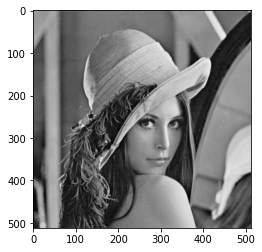

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.util import random_noise

img=cv2.imread("images/Lena.png",0)
print("original image:")
plt.imshow(img,cmap="gray")
plt.show()

In [3]:
def correlate2d(img,w):

    w_x=w.shape[0]
    w_y=w.shape[1]
    img_padded=np.zeros((img.shape[0]+w_x-1,img.shape[1]+w_y-1))
    x_shift=w_x//2
    y_shift=w_y//2
    extra_x= 1 if w_x%2==0 else 0
    extra_y= 1 if w_y%2==0 else 0
    img_padded[x_shift:-x_shift+extra_x,y_shift:-y_shift+extra_y]=img

    corr=np.empty_like(img,dtype=float)
    for x in range(corr.shape[0]):
        for y in range(corr.shape[1]):
            corr[x][y]=np.sum(np.multiply(img_padded[x:x+w_x,y:y+w_y],w))

    return corr

def median_filter(img,window_size):

    img_padded=np.full((img.shape[0]+window_size-1,img.shape[1]+window_size-1),-1)
    shift=window_size//2
    img_padded[shift:-shift,shift:-shift]=img

    size_=window_size**2
    median_img=np.empty_like(img)
    for x in range(median_img.shape[0]):
        for y in range(median_img.shape[1]):
            candidates=np.reshape(img_padded[x:x+window_size,y:y+window_size],(size_))
            if x<shift or y<shift:
                candidates=candidates[candidates!=-1]
            median_img[x,y]=np.median(candidates)

    return median_img

avg filter window for window size 3:
[[0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]]
avg filter window for window size 5:
[[0.04 0.04 0.04 0.04 0.04]
 [0.04 0.04 0.04 0.04 0.04]
 [0.04 0.04 0.04 0.04 0.04]
 [0.04 0.04 0.04 0.04 0.04]
 [0.04 0.04 0.04 0.04 0.04]]
avg filter window for window size 7:
[[0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]
 [0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816]]


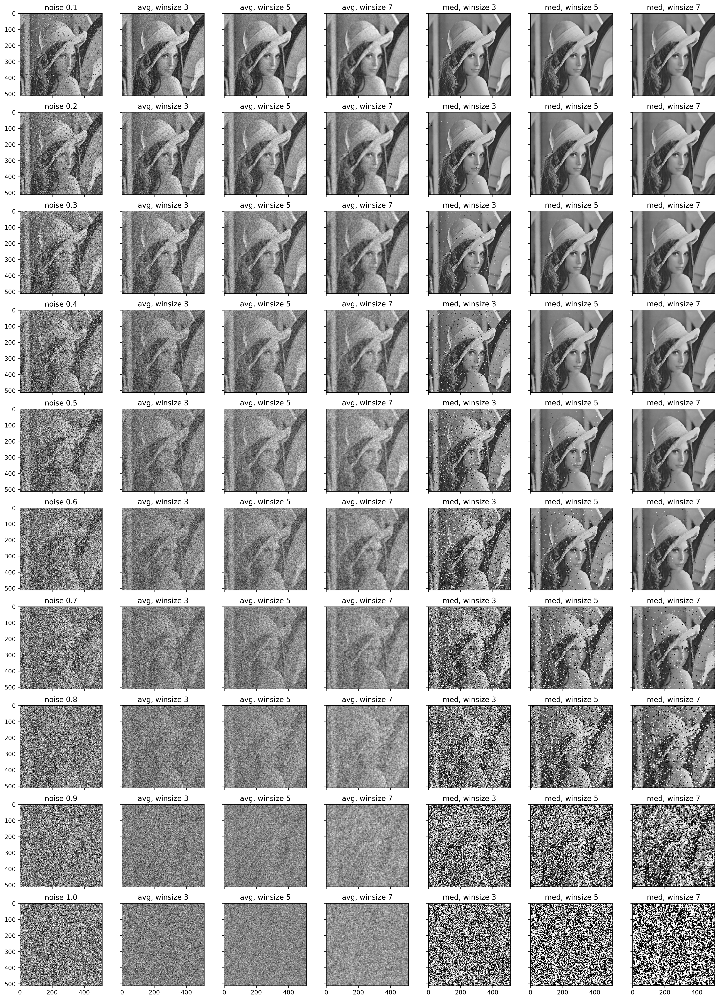

In [35]:
fig, ax = plt.subplots(nrows=10, ncols=7, figsize=(21,30), dpi=240, sharex=True, sharey=True)

images_with_noise=[]
for i in range(1,11):
    images_with_noise.append((random_noise(img, mode="s&p", amount=i/10)*255).astype(np.uint8))
    ax[i-1][0].imshow(images_with_noise[-1], cmap="gray")
    ax[i-1][0].set_title(f"noise {i/10}",fontsize=12)
    
sizes=[3,5,7]

for size,col_index in zip(sizes,[1,2,3]):
    
    w=np.array([[1/size**2]*size]*size)
    print(f"avg filter window for window size {size}:\n{w}")
    
    for i,noise_img in enumerate(images_with_noise):
        
        avg_img=correlate2d(noise_img,w)
        ax[i][col_index].imshow(avg_img,cmap="gray")
        ax[i][col_index].set_title(f"avg, winsize {size}",fontsize=12)
        
        median_img=median_filter(noise_img,size)
        ax[i][col_index+3].imshow(median_img,cmap="gray")
        ax[i][col_index+3].set_title(f"med, winsize {size}",fontsize=12)
        
plt.show()

In [4]:
def normalised_cross_correlation(f,w):
    
    assert (f.ndim==2 and w.ndim==2),"both f and w must be greyscale images"
    f_mean=np.mean(f)
    w_mean=np.mean(w)
    f_=f-f_mean
    w_=w-w_mean
    corr=correlate2d(f_,w_)
    norm=(np.sum(np.square(f_))*np.sum(np.square(w_)))**0.5
    return corr/norm

def mark_point_and_draw_box(img,center,left_top,right_bottom):
    
    # indices have to be reversed since opencv uses column, row notation
    
    x=tuple(center[::-1])
    cv2.circle(img, x, 6, color=(255,0,0), thickness=-1)
    
    x=tuple(center[::-1]-[10,10])
    y=tuple(center[::-1]+[10,10])
    cv2.line(img, x, y, (255,0,0), 2)
    
    x=tuple(center[::-1]+[10,-10])
    y=tuple(center[::-1]+[-10,10])
    cv2.line(img, x, y, (255,0,0), 2)
    
    x=tuple(left_top[::-1])
    y=tuple(right_bottom[::-1])
    cv2.rectangle(img, x, y, color=(255,0,0), thickness=2)

def locate(f,w):
    
    # get matching locations
    ncc_mat=normalised_cross_correlation(f,w)
    std=np.std(ncc_mat)
    T=np.amax(ncc_mat)-std*0.01
    locs=np.argwhere(ncc_mat>=T)
    shift=np.array(w.shape)//2
    
    # draw rectangles over matched areas
    output_img=cv2.cvtColor(f,cv2.COLOR_GRAY2BGR)
    for center,s,e in zip(locs,locs-shift,locs+shift):
        mark_point_and_draw_box(output_img,center,s,e)
    
    return output_img,locs

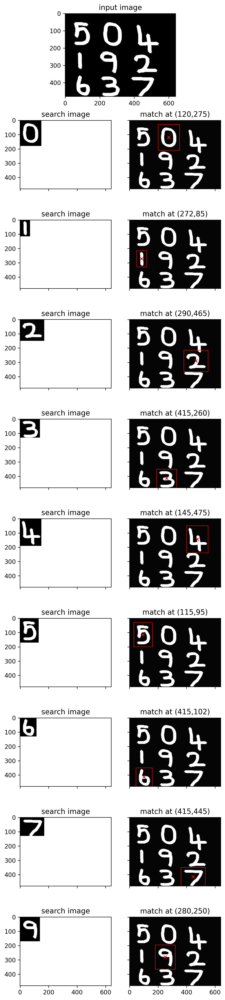

In [5]:
hdraw=np.array(cv2.imread("images/hdraw.png",0))

hdraw_cropped=[]
for i in [0,1,2,3,4,5,6,7,9]:
    hdraw_cropped.append(np.array(cv2.imread(f"images/hdraw_{i}.png",0)))
    
fig, ax = plt.subplots(nrows=10, ncols=2, figsize=(6,30), dpi=240, sharex=True, sharey=True)

gs = ax[0,0].get_gridspec()
for a in ax[0]:
    a.remove()
axbig = fig.add_subplot(gs[0,:])

axbig.imshow(hdraw,cmap="gray")
axbig.set_title("input image",fontsize=12)

for search_img,row_index in zip(hdraw_cropped,range(1,10)):
    
    ax[row_index][0].imshow(search_img,cmap="gray")
    ax[row_index][0].set_title("search image",fontsize=12)

    box_img,locs=locate(hdraw,search_img)

    ax[row_index][1].imshow(box_img)
    ax[row_index][1].set_title(f"match at ({locs[0][0]},{locs[0][1]})",fontsize=12)
    
plt.show()

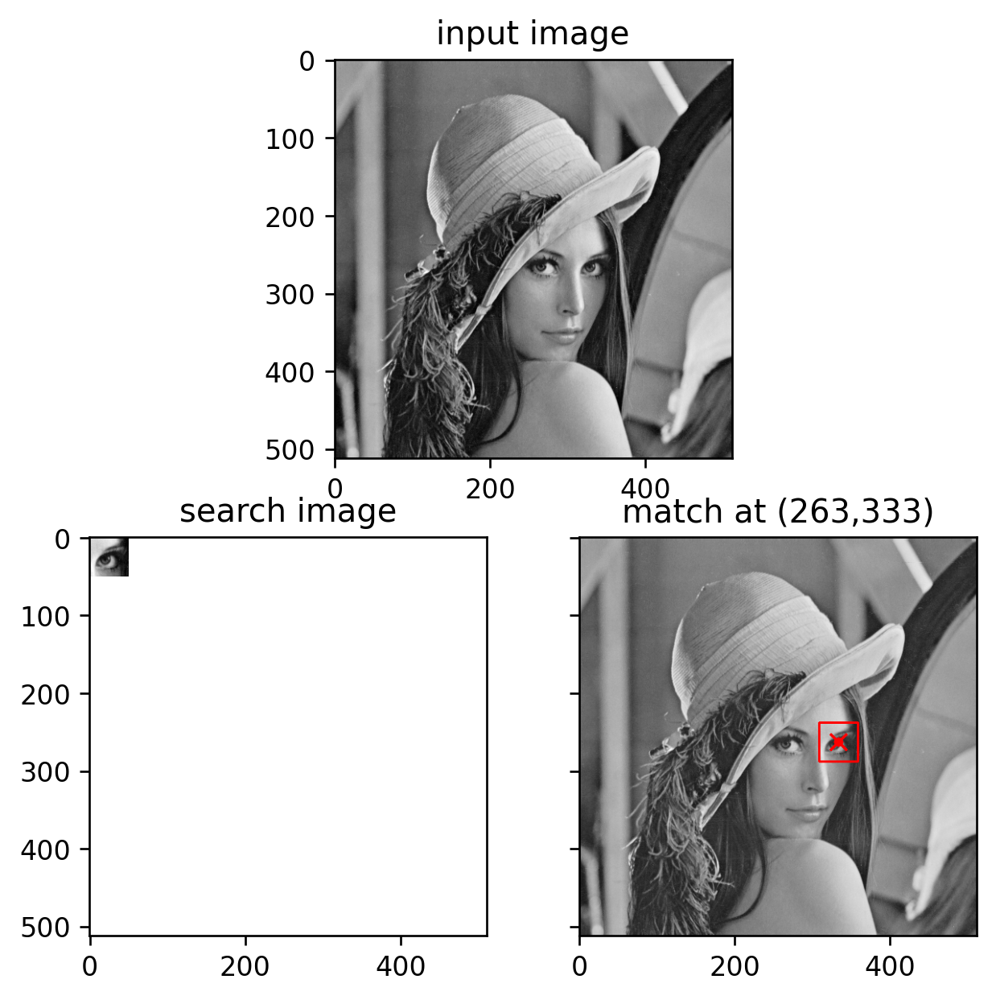

In [38]:
img_np=np.array(img)
left_eye_np=np.array(cv2.imread("images/Lena_left_eye.png",0))

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(6,6), dpi=240, sharex=True, sharey=True)
gs = ax[0,0].get_gridspec()
for a in ax[0]:
    a.remove()
axbig = fig.add_subplot(gs[0,:])

axbig.imshow(img_np,cmap="gray")
axbig.set_title("input image",fontsize=12)

ax[1][0].imshow(left_eye_np,cmap="gray")
ax[1][0].set_title("search image",fontsize=12)

box_img,locs=locate(img_np,left_eye_np)

ax[1][1].imshow(box_img)
ax[1][1].set_title(f"match at ({locs[0][0]},{locs[0][1]})",fontsize=12)

plt.show()